<a href="https://colab.research.google.com/github/bhatnira/Interpretation-of-Best-Classification-Models-Acetylcholinesterase-Inhibitor-Discovery-/blob/main/ModelInterpretation_RdkitFeatureBasedAutoMLModel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Model interpretation of rdkit based AutoML model

## Introduction

The capacity of deep and machine learning models to discern intricate, nonlinear links between inputs and outputs, while impressive, also presents a challenge: these processes often remain opaque to human understanding. In the realm of drug design and discovery,  Explainable AI( XAI) has the potential to significantly enhance our understanding of the intricacies involved in error occurrences, non-linear responses, and seemingly random phenomena(Jiménez-Luna et al., 2020).


## Data loading and Preprocessing



In [ ]:
# For Reporducibility
import numpy as np
np.random.seed(42)

In [ ]:
# Tpot requires numpy==1.23.3 as of june 2024
!pip install numpy==1.23.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 13.3 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.25.2
    Uninstalling numpy-1.25.2:
      Successfully uninstalled numpy-1.25.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
chex 0.1.86 requires numpy>=1.24.1, but you have numpy 1.23.3 which is incompatible.
pandas-stubs 2.0.3.230814 requires numpy>=1.25.0; python_version >= "3.9", but you have numpy 1.23.3 which is incompatible.
tensorflow 2.15.0 requires numpy<2.0.0,>=1.23.5, but you have numpy 1.23.3 which is incompatible.


In [ ]:
# Mount Drive in Colab environment
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Data loading

Acquisition of the primary molecular dataset of the human acetylcholinesterase inhibitor was done from ChEMBL(ID:ChEMBL22). From 18,204 inhibitor entries, 4077 compounds with reported IC50 value and validated SMILE annotations were chosen, with redundant chemical structures resolved by randomly selecting one from the most frequently occurring activity label group. The resulting dataset comprises 2,330 instances labeled as positive and 1,747 instances labeled as negative. Molecules with an IC50 value less than 1uM were labeled as positives, and greater than 1 uM were labeled as negatives.  

In [ ]:
# Load dataset
import pandas as pd
df=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/Part_2_standarizationOfMolecule/StandarizedSmiles_cutOFF800daltonMolecularweight.xlsx')
df.head(5)

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,tSNE1,tSNE2,MolecularWeight,Frequency,cleanedMol
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,-52.761700,-42.736099,275.352,27,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C
1,CHEMBL207777,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,97.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88190>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.014164,-1.325272,-63.027809,-53.765778,325.364,1,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2
2,CHEMBL205967,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,2420.0,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88270>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.235565,-1.559108,-61.968063,-54.078575,263.293,1,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2
3,CHEMBL60119,Cc1ccc2c(N)c3c(nc2c1)CCCC3,100.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88430>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,2.705664,0.148113,57.758297,-8.911607,212.296,4,Cc1ccc2c(N)c3c(nc2c1)CCCC3
4,CHEMBL294525,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2,290.0,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e884a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.600017,-0.978574,61.242554,5.783804,341.455,3,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2


In [ ]:
# Installing RDKit from PyPI
!pip install rdkit-pypi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.4/29.4 MB 33.8 MB/s eta 0:00:00


### Descriptor generation and feature preparation


The code for descriptor calculation was adopted form blogpost by [@greglandrum](https://https://greglandrum.github.io/rdkit-blog/posts/2022-12-23-descriptor-tutorial.html)

In [ ]:
# Importing pandas as pd
import pandas as pd

# Importing required modules from RDKit
from rdkit import Chem
from rdkit.Chem import Descriptors

# Define a function to calculate the full list of descriptors for a molecule
def calculate_molecular_descriptors(molecule, missing_value=None):
    # Initialize an empty dictionary to store descriptor values
    result = {}

    # Iterate through the descriptor list and calculate descriptors for the molecule
    for name, function in Descriptors._descList:
        # Some descriptor functions may throw errors if they fail, catch those here
        try:
            # Calculate descriptor value for the molecule
            value = function(molecule)
        except:
            # Print the error message
            import traceback
            traceback.print_exc()
            # Set the descriptor value to the specified missing value
            value = missing_value
        # Store the descriptor value in the result dictionary
        result[name] = value
    return result

# Define a list to store the computed descriptors for each molecule
descriptor_list = []

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles_string in df['cleanedMol']:
    # Convert SMILES string to RDKit molecule object
    molecule = Chem.MolFromSmiles(smiles_string)

    # Check if the molecule is valid
    if molecule is not None:
        # Calculate descriptors using the calculate_molecular_descriptors function
        descriptors = calculate_molecular_descriptors(molecule, missing_value=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
descriptor_df = pd.DataFrame(descriptor_list)

# Merge the original DataFrame with the descriptor DataFrame
df = pd.concat([df, descriptor_df], axis=1)

In [ ]:
# Drop any feature containing null values
df.dropna(axis=1)

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0,0,0,0,0,0,0,0,0,0
1,CHEMBL207777,Cc1ccccc1NC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,97.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88190>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.014164,-1.325272,...,0,0,0,0,0,0,0,0,0,0
2,CHEMBL205967,CCNC(=O)Oc1ccc2c(c1)[C@]1(C)CO[C@@H](C1)O2,2420.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88270>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.235565,-1.559108,...,0,0,0,0,0,0,0,0,0,0
3,CHEMBL60119,Cc1ccc2c(N)c3c(nc2c1)CCCC3,100.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e88430>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,2.705664,0.148113,...,0,0,0,0,0,0,0,0,0,0
4,CHEMBL294525,CCCCCCCNc1c2c(nc3cc([N+](=O)[O-])ccc13)CCCC2,290.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e884a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.600017,-0.978574,...,0,0,0,0,0,0,0,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4072,CHEMBL4077157,O=C(Nc1ccc(CN2CCOCC2)cc1C(=O)C(=O)N1C(=O)CCC1=...,229.08,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327c30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.478199,1.261641,...,0,0,0,0,0,0,0,0,0,0
4073,CHEMBL3906317,COc1cccc2c1C=[N+](c1ccccc1C(F)(F)F)CC2.[Br-],10000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327ca0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.671263,-0.016301,...,0,0,0,0,0,0,0,0,0,0
4074,CHEMBL4800328,COc1cccc2cc[n+](-c3ccc(C)cc3)cc12.[Br-],1080.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.586529,-0.433179,...,0,0,0,0,0,0,0,0,0,0
4075,CHEMBL4797670,COc1ccc(-[n+]2ccc3cccc(OC)c3c2)cc1.[Br-],140.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfdd327d80>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.677524,-0.748477,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Feature Set for tpot modelling
feature1=df.iloc[:, 15:]

In [ ]:
feature1

,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,NumRadicalElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,11.353370,-0.429125,11.353370,0.098109,0.848240,275.352,254.184,275.163377,108,0,...,0,0,0,0,0,0,0,0,0,0
1,12.152013,-0.507704,12.152013,0.093140,0.906446,325.364,306.212,325.131408,124,0,...,0,0,0,0,0,0,0,0,0,0
2,11.430389,-0.439927,11.430389,0.056694,0.888271,263.293,246.157,263.115758,102,0,...,0,0,0,0,0,0,0,0,0,0
3,6.249844,0.958056,6.249844,0.958056,0.728716,212.296,196.168,212.131349,82,0,...,0,0,0,0,0,0,0,0,0,0
4,11.077636,-0.345833,11.077636,0.112292,0.396155,341.455,314.239,341.210327,134,0,...,0,0,0,0,0,0,0,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4072,13.153269,-1.144692,13.153269,0.039314,0.390527,449.463,426.279,449.158685,170,0,...,0,0,0,0,0,0,0,0,0,0
4073,13.179451,-4.369559,13.179451,0.172737,0.762966,306.307,291.187,306.110025,114,0,...,0,0,0,0,0,0,0,0,0,0
4074,5.424113,0.901816,5.424113,0.901816,0.635009,250.321,234.193,250.122641,94,0,...,0,0,0,0,0,0,0,0,0,0
4075,5.421510,0.854370,5.421510,0.854370,0.679519,266.320,250.192,266.117555,100,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Get the list of columns containing NaN values
columns_with_nan = feature1.columns[feature1.isna().any()].tolist()
print(columns_with_nan)

['MaxPartialCharge', 'MinPartialCharge', 'MaxAbsPartialCharge', 'MinAbsPartialCharge', 'BCUT2D_MWHI', 'BCUT2D_MWLOW', 'BCUT2D_CHGHI', 'BCUT2D_CHGLO', 'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'BCUT2D_MRLOW']


In [ ]:

# Calculate variance for each column in 'feature1'.
variances = feature1.var()
# Threshold for low variability.
threshold = 0
# Identify columns with variability below the threshold.
low_variability_columns = variances[variances == threshold].index
# Drop columns with low variability from the DataFrame 'feature1'.
feature1.drop(columns=low_variability_columns, inplace=True)
feature1

,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,MaxPartialCharge,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,11.353370,-0.429125,11.353370,0.098109,0.848240,275.352,254.184,275.163377,108,0.411839,...,0,0,0,0,0,0,0,0,0,0
1,12.152013,-0.507704,12.152013,0.093140,0.906446,325.364,306.212,325.131408,124,0.416597,...,0,0,0,0,0,0,0,0,0,0
2,11.430389,-0.439927,11.430389,0.056694,0.888271,263.293,246.157,263.115758,102,0.412091,...,0,0,0,0,0,0,0,0,0,0
3,6.249844,0.958056,6.249844,0.958056,0.728716,212.296,196.168,212.131349,82,0.072836,...,0,0,0,0,0,0,0,0,0,0
4,11.077636,-0.345833,11.077636,0.112292,0.396155,341.455,314.239,341.210327,134,0.271131,...,0,0,0,0,0,0,0,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4072,13.153269,-1.144692,13.153269,0.039314,0.390527,449.463,426.279,449.158685,170,0.308243,...,0,0,0,0,0,0,0,0,0,0
4073,13.179451,-4.369559,13.179451,0.172737,0.762966,306.307,291.187,306.110025,114,0.422266,...,0,0,0,0,0,0,0,0,0,0
4074,5.424113,0.901816,5.424113,0.901816,0.635009,250.321,234.193,250.122641,94,0.210146,...,0,0,0,0,0,0,0,0,0,0
4075,5.421510,0.854370,5.421510,0.854370,0.679519,266.320,250.192,266.117555,100,0.210400,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
target=df['classLabel']
target.head()

0    1
1    1
2    0
3    1
4    1
Name: classLabel, dtype: int64

In [ ]:
# List of column names to drop from the DataFrame 'feature1'.
column_name_to_drop = [
    'MaxPartialCharge', 'MinPartialCharge', 'MaxAbsPartialCharge', 'MinAbsPartialCharge',
    'BCUT2D_MWHI', 'BCUT2D_MWLOW', 'BCUT2D_CHGHI', 'BCUT2D_CHGLO',
    'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'BCUT2D_MRLOW'
]
# Remove columns with missing value
feature1 = feature1.drop(columns=column_name_to_drop)

In [ ]:
feature1.columns.tolist()

['MaxEStateIndex',
 'MinEStateIndex',
 'MaxAbsEStateIndex',
 'MinAbsEStateIndex',
 'qed',
 'MolWt',
 'HeavyAtomMolWt',
 'ExactMolWt',
 'NumValenceElectrons',
 'FpDensityMorgan1',
 'FpDensityMorgan2',
 'FpDensityMorgan3',
 'BalabanJ',
 'BertzCT',
 'Chi0',
 'Chi0n',
 'Chi0v',
 'Chi1',
 'Chi1n',
 'Chi1v',
 'Chi2n',
 'Chi2v',
 'Chi3n',
 'Chi3v',
 'Chi4n',
 'Chi4v',
 'HallKierAlpha',
 'Ipc',
 'Kappa1',
 'Kappa2',
 'Kappa3',
 'LabuteASA',
 'PEOE_VSA1',
 'PEOE_VSA10',
 'PEOE_VSA11',
 'PEOE_VSA12',
 'PEOE_VSA13',
 'PEOE_VSA14',
 'PEOE_VSA2',
 'PEOE_VSA3',
 'PEOE_VSA4',
 'PEOE_VSA5',
 'PEOE_VSA6',
 'PEOE_VSA7',
 'PEOE_VSA8',
 'PEOE_VSA9',
 'SMR_VSA1',
 'SMR_VSA10',
 'SMR_VSA2',
 'SMR_VSA3',
 'SMR_VSA4',
 'SMR_VSA5',
 'SMR_VSA6',
 'SMR_VSA7',
 'SMR_VSA9',
 'SlogP_VSA1',
 'SlogP_VSA10',
 'SlogP_VSA11',
 'SlogP_VSA12',
 'SlogP_VSA2',
 'SlogP_VSA3',
 'SlogP_VSA4',
 'SlogP_VSA5',
 'SlogP_VSA6',
 'SlogP_VSA7',
 'SlogP_VSA8',
 'TPSA',
 'EState_VSA1',
 'EState_VSA10',
 'EState_VSA11',
 'EState_VSA2',
 

## AutoML Modeling

In [ ]:
!pip install tpot

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.4/87.4 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 13.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for stopit: filename=stopit-1.1.2-py3-none-any.whl size=11938 sha256=7896c8828e4b8a030bd6fa281837718859e0d4fd97e7d6577f6e74dc24fd3b7c
  Stored in directory: /root/.cache/pip/wheels/af/f9/87/bf5b3d565c2a007b4dae9d8142dccc85a9f164e517062dd519
Successfully built stopit
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


In [ ]:
# Import necessary libraries
from tpot import TPOTClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (
    accuracy_score, matthews_corrcoef, cohen_kappa_score, confusion_matrix,
    classification_report, precision_score, recall_score, f1_score,
    roc_curve, auc
)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import joblib

# Split the data into training and test sets
from sklearn.model_selection import train_test_split
# Split the data into training and testing sets using stratified sampling
X_train, X_test, y_train, y_test = train_test_split(feature1, target, test_size=0.20, stratify=target, random_state=42)
# Create an instance of TPOTClassifier with five fold cross validation
tpot = TPOTClassifier(generations=5, population_size=20, cv=5, random_state=42, verbosity=2)
# Fit TPOT to the training data
tpot.fit(X_train, y_train)
# Get the best pipeline from TPOT
best_pipeline = tpot.fitted_pipeline_


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.8638445494602541

Generation 2 - Current best internal CV score: 0.8650729525831696

Generation 3 - Current best internal CV score: 0.8650729525831696

Generation 4 - Current best internal CV score: 0.8650729525831696

Generation 5 - Current best internal CV score: 0.8650729525831696

Best pipeline: ExtraTreesClassifier(input_matrix, bootstrap=False, criterion=entropy, max_features=0.35000000000000003, min_samples_leaf=1, min_samples_split=15, n_estimators=100)


### Evaluation of AutoML Model

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (precision_score, recall_score, f1_score,
                             roc_auc_score, cohen_kappa_score,
                             matthews_corrcoef, accuracy_score)
from sklearn.model_selection import cross_val_score
import joblib

feature_names = X_train.columns.tolist()
# Make predictions on the test data
y_test_pred = best_pipeline.predict(X_test)

# Calculate evaluation metrics
precision = precision_score(y_test, y_test_pred, average='weighted')
recall = recall_score(y_test, y_test_pred, average='weighted')
f1 = f1_score(y_test, y_test_pred, average='weighted')
roc_auc = roc_auc_score(y_test, y_test_pred)
cohen_kappa = cohen_kappa_score(y_test, y_test_pred)
mcc = matthews_corrcoef(y_test, y_test_pred)

# Calculate cross-validation scores, std, and 95% CI
cv_scores = cross_val_score(best_pipeline, X_train, y_train, cv=5)
cv_mean_score = np.mean(cv_scores)
cv_std = np.std(cv_scores)
cv_ci = 1.96 * cv_std  # 95% confidence interval

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_test_pred)

# Store the evaluation results
evaluation_results = {
    'Model': ['TPOT Best Pipeline'],
    'Precision': [precision],
    'Recall': [recall],
    'F1 Score': [f1],
    'ROC-AUC': [roc_auc],
    'Cohen\'s Kappa': [cohen_kappa],
    'MCC': [mcc],
    'CV Mean Score': [cv_mean_score],
    'CV Std Dev': [cv_std],
    'CV 95% CI': [cv_ci],
    'Test Accuracy': [test_accuracy],
    'Features': [feature_names]
}

# Convert the evaluation results to a DataFrame
evaluation_df = pd.DataFrame(evaluation_results)

# Save the evaluation results to an Excel file
evaluation_df.to_excel('tpot_best_pipeline_evaluation.xlsx', index=False)
print("Evaluation results of TPOT best pipeline saved to 'tpot_best_pipeline_evaluation.xlsx'.")

# Display the evaluation results
print("\nEvaluation Results:")
print(evaluation_df)

# Save the best model parameters to a DataFrame
best_model_parameters = pd.DataFrame([best_pipeline.get_params()])

# Combine the evaluation results, best model parameters, and feature names into a single DataFrame
results_df = pd.concat([evaluation_df, best_model_parameters], axis=1)

# Save the combined information to an Excel file
results_df.to_excel('tpot_best_pipeline_results.xlsx', index=False)
print("\nEvaluation results, best model parameters, and feature names saved to 'tpot_best_pipeline_results.xlsx'.")

# Display the combined information
print("\nCombined Information:")
print(results_df)


Evaluation results of TPOT best pipeline saved to 'tpot_best_pipeline_evaluation.xlsx'.

Evaluation Results:
                Model  Precision    Recall  F1 Score  ROC-AUC  Cohen's Kappa  \
0  TPOT Best Pipeline    0.85684  0.856618   0.85576  0.84886       0.704483   

        MCC  CV Mean Score  CV Std Dev  CV 95% CI  Test Accuracy  \
0  0.706127       0.865073    0.009341   0.018309       0.856618   

                                            Features  
0  [MaxEStateIndex, MinEStateIndex, MaxAbsEStateI...  

Evaluation results, best model parameters, and feature names saved to 'tpot_best_pipeline_results.xlsx'.

Combined Information:
                Model  Precision    Recall  F1 Score  ROC-AUC  Cohen's Kappa  \
0  TPOT Best Pipeline    0.85684  0.856618   0.85576  0.84886       0.704483   

        MCC  CV Mean Score  CV Std Dev  CV 95% CI  ...  \
0  0.706127       0.865073    0.009341   0.018309  ...   

   extratreesclassifier__min_samples_leaf  \
0                              

## Model Interpretation with LIME






In [ ]:
!pip install lime

In [ ]:
tpot_column= feature1.columns.tolist()

In [ ]:
X_test_e=test_df.loc[:, 'MaxEStateIndex':]

In [ ]:
from lime import lime_tabular

# Initialize the LIME explainer
explainer = lime_tabular.LimeTabularExplainer(X_train.values,
                                               feature_names=tpot_column,
                                               class_names=["0", "1"],
                                               discretize_continuous=True)

# Select a specific instance for explanation
instance_idx = 0
instance = X_test.iloc[instance_idx]

# Generate an explanation for the instance
explanation = explainer.explain_instance(instance.values, best_pipeline.predict_proba)

# Show the explanation
explanation.show_in_notebook()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning:

X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not 

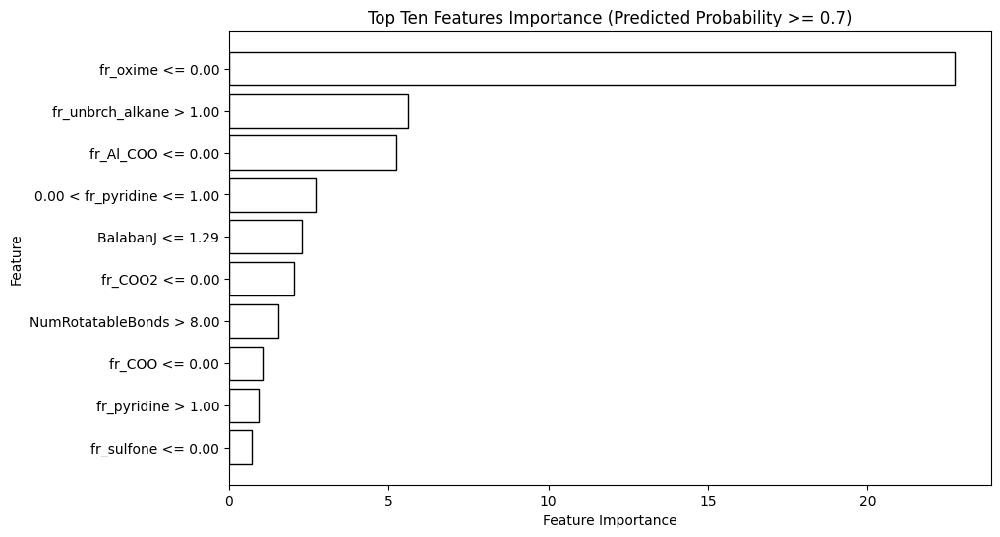

In [ ]:
import matplotlib.pyplot as plt
from lime import lime_tabular

# Set prediction threshold
threshold = 0.7

# Initialize the LIME explainer
explainer = lime_tabular.LimeTabularExplainer(X_train.values,
                                              feature_names=tpot_column,
                                              class_names=["0", "1"],
                                              discretize_continuous=True)

# Generate explanations for instances where predicted probability exceeds the threshold
explanations = []
for i in range(len(X_test_e)):
    instance = X_test_e.iloc[i]
    predicted_proba = best_pipeline.predict_proba(instance.values.reshape(1, -1))[0][1]
    if predicted_proba >= threshold:
        explanation = explainer.explain_instance(instance.values, best_pipeline.predict_proba)
        explanations.append(explanation)

# Extract feature importances from the explanations
feature_importances = [exp.as_list() for exp in explanations]

# Combine feature importances from all explanations
combined_importances = {}
for exp in feature_importances:
    for feature, importance in exp:
        if feature in combined_importances:
            combined_importances[feature] += importance
        else:
            combined_importances[feature] = importance

# Sort features by importance
sorted_features = sorted(combined_importances.items(), key=lambda x: x[1], reverse=True)

# Select top ten features and their importances
top_features = [feature[0] for feature in sorted_features[:10]]
importances = [feature[1] for feature in sorted_features[:10]]

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.barh(top_features, importances, color='white', edgecolor='black')
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Top Ten Features Importance (Predicted Probability >= 0.7)')
plt.gca().invert_yaxis()

# Customize edge color for each bar
for bar in bars:
    bar.set_edgecolor('black')

plt.show()


### Lime Interpretation on 10 selected AChE inhibitors

In [ ]:
# List of commonly known acetylcholinesterase inhibitor
chembl_ids = ['CHEMBL94', 'CHEMBL54126', 'CHEMBL636', 'CHEMBL113', 'CHEMBL659', 'CHEMBL95', 'CHEMBL1128', 'CHEMBL1255901','CHEMBL502', 'CHEMBL75013', 'CHEMBL359570', 'CHEMBL75013']

# Select rows where the 'chembl_id' column is in the list of ChEMBL IDs
specific_rows = df[df['Molecule ChEMBL ID'].isin(chembl_ids)]

In [ ]:
specific_rows_fetures=specific_rows.loc[:, 'MaxEStateIndex':]

In [ ]:
tpot_column= feature1.columns.tolist()

In [ ]:
specific_rows_fetures=specific_rows_fetures
selected_features=specific_rows_fetures[tpot_column]

In [ ]:
specific_rows

,Molecule ChEMBL ID,Smiles,IC50,classLabel,IsValidSMILES,Morgan_FP,Molecule,Fingerprint,PCA1,PCA2,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e880b0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.738898,-1.494784,...,0,0,0,0,0,0,0,0,0,0
6,CHEMBL95,Nc1c2c(nc3ccccc13)CCCC2,45.10,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e886d0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,3.127724,0.704160,...,0,0,0,0,0,0,0,0,0,0
13,CHEMBL1255901,C/C=C1\[C@H]2C=C(C)C[C@@]1(N)c1ccc(=O)[nH]c1C2,5.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e889e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.862149,-0.194694,...,0,0,0,0,0,0,0,0,0,0
35,CHEMBL502,COc1cc2c(cc1OC)C(=O)C(CC1CCN(Cc3ccccc3)CC1)C2,10.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e89380>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.143176,2.991514,...,0,0,0,0,0,0,0,0,0,0
80,CHEMBL75013,O=C(CCC1CCN(Cc2ccccc2)CC1)c1ccc2c(c1)NCCCC2,194.98,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8a7a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.595382,3.203060,...,0,0,0,0,0,0,0,0,0,0
143,CHEMBL659,COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2,2090.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e84660>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.604482,-0.005219,...,0,0,0,0,0,0,0,0,0,0
387,CHEMBL636,CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1,3030.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e8fd10>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.223036,-1.661954,...,0,0,0,0,0,0,0,0,0,0
446,CHEMBL54126,CN(C)C(=O)Oc1cccc([N+](C)(C)C)c1.[Br-],31.00,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd93d59a0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-1.028787,-1.489257,...,0,0,0,0,0,0,0,0,0,0
1000,CHEMBL1128,CC[N+](C)(C)c1cccc(O)c1.[Cl-],5000.00,0,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd94033e0>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.511788,-0.445985,...,0,0,0,0,0,0,0,0,0,0
2234,CHEMBL359570,O=C1Cc2cc3c(CCC4CCN(Cc5ccccc5)CC4)noc3cc2N1,0.33,1,True,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,<rdkit.Chem.rdchem.Mol object at 0x7bcfd8e74b30>,<rdkit.DataStructs.cDataStructs.ExplicitBitVec...,-0.638255,3.542295,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
selected_features

,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,FpDensityMorgan1,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,11.353370,-0.429125,11.353370,0.098109,0.848240,275.352,254.184,275.163377,108,1.450000,...,0,0,0,0,0,0,0,0,0,0
6,6.199769,0.953981,6.199769,0.953981,0.706488,198.269,184.157,198.115698,76,1.066667,...,0,0,0,0,0,0,0,0,0,0
13,11.454454,-0.434491,11.454454,0.041618,0.683535,242.322,224.178,242.141913,94,1.500000,...,0,0,0,0,0,0,0,0,0,0
35,12.936933,0.108783,12.936933,0.108783,0.747461,379.500,350.268,379.214744,148,1.000000,...,0,0,0,0,0,0,0,0,0,0
80,12.726380,0.306076,12.726380,0.306076,0.693540,376.544,344.288,376.251464,148,1.035714,...,0,0,0,0,0,0,0,0,0,0
143,9.972866,-0.411699,9.972866,0.008380,0.800524,287.359,266.191,287.152144,112,1.428571,...,0,0,0,0,0,0,0,0,0,0
387,11.651792,-0.326707,11.651792,0.284775,0.823422,250.342,228.166,250.168128,100,1.333333,...,0,0,0,0,0,0,0,0,0,0
446,11.371809,-0.362445,11.371809,0.362445,0.717081,223.296,204.144,223.144104,88,1.250000,...,1,0,0,0,0,0,0,0,0,0
1000,9.261910,0.339954,9.261910,0.339954,0.665970,166.244,150.116,166.122641,66,1.333333,...,1,0,0,0,0,0,0,0,0,0
2234,9.604241,0.065227,9.604241,0.065227,0.522778,375.472,350.272,375.194677,144,1.107143,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
specific_cols = specific_rows[['Molecule ChEMBL ID', 'Smiles', 'IC50', 'classLabel']]

combined_df = pd.concat([specific_cols, selected_features], axis=1)

In [ ]:
combined_df

,Molecule ChEMBL ID,Smiles,IC50,classLabel,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,11.353370,-0.429125,11.353370,0.098109,0.848240,275.352,...,0,0,0,0,0,0,0,0,0,0
6,CHEMBL95,Nc1c2c(nc3ccccc13)CCCC2,45.10,1,6.199769,0.953981,6.199769,0.953981,0.706488,198.269,...,0,0,0,0,0,0,0,0,0,0
13,CHEMBL1255901,C/C=C1\[C@H]2C=C(C)C[C@@]1(N)c1ccc(=O)[nH]c1C2,5.00,1,11.454454,-0.434491,11.454454,0.041618,0.683535,242.322,...,0,0,0,0,0,0,0,0,0,0
35,CHEMBL502,COc1cc2c(cc1OC)C(=O)C(CC1CCN(Cc3ccccc3)CC1)C2,10.00,1,12.936933,0.108783,12.936933,0.108783,0.747461,379.500,...,0,0,0,0,0,0,0,0,0,0
80,CHEMBL75013,O=C(CCC1CCN(Cc2ccccc2)CC1)c1ccc2c(c1)NCCCC2,194.98,1,12.726380,0.306076,12.726380,0.306076,0.693540,376.544,...,0,0,0,0,0,0,0,0,0,0
143,CHEMBL659,COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2,2090.00,0,9.972866,-0.411699,9.972866,0.008380,0.800524,287.359,...,0,0,0,0,0,0,0,0,0,0
387,CHEMBL636,CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1,3030.00,0,11.651792,-0.326707,11.651792,0.284775,0.823422,250.342,...,0,0,0,0,0,0,0,0,0,0
446,CHEMBL54126,CN(C)C(=O)Oc1cccc([N+](C)(C)C)c1.[Br-],31.00,1,11.371809,-0.362445,11.371809,0.362445,0.717081,223.296,...,1,0,0,0,0,0,0,0,0,0
1000,CHEMBL1128,CC[N+](C)(C)c1cccc(O)c1.[Cl-],5000.00,0,9.261910,0.339954,9.261910,0.339954,0.665970,166.244,...,1,0,0,0,0,0,0,0,0,0
2234,CHEMBL359570,O=C1Cc2cc3c(CCC4CCN(Cc5ccccc5)CC4)noc3cc2N1,0.33,1,9.604241,0.065227,9.604241,0.065227,0.522778,375.472,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
combined_df.reset_index(drop=True, inplace=True)

### Lime interpretations visualization

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but ExtraTreesClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:493: UserWarning: X does not 

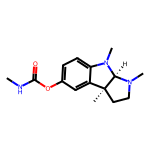

Explanation for instance 0:


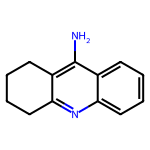

Explanation for instance 1:


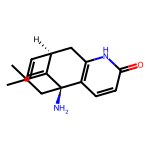

Explanation for instance 2:


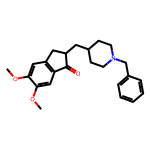

Explanation for instance 3:


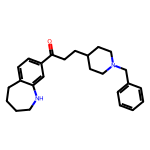

Explanation for instance 4:


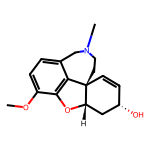

Explanation for instance 5:


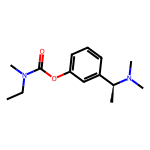

Explanation for instance 6:


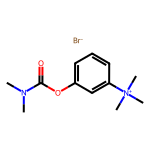

Explanation for instance 7:


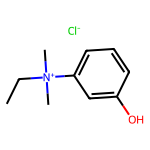

Explanation for instance 8:


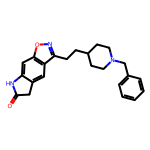

Explanation for instance 9:


In [ ]:
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import Draw
import matplotlib.pyplot as plt
import lime
import lime.lime_tabular

# Extract features
feature_columns = combined_df.loc[:, 'MaxEStateIndex':]

# Convert to numpy array if necessary
X = feature_columns.values

# Initialize the LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(X,
                                                  feature_names=feature_columns.columns,
                                                  class_names=["0", "1"],
                                                  discretize_continuous=True)

# Loop through each compound in the DataFrame and generate explanations
explanations = []
for instance_idx in range(X.shape[0]):
    instance = X[instance_idx]

    # Extract and draw compound structure
    smiles = combined_df.loc[instance_idx, 'Smiles']
    mol = Chem.MolFromSmiles(smiles)
    img = Draw.MolToImage(mol, size=(150, 150))

    explanation = explainer.explain_instance(instance, best_pipeline.predict_proba)
    explanations.append((img, explanation))

# Show the explanations in the notebook
for idx, (img, explanation) in enumerate(explanations):
    display(img)
    print(f"Explanation for instance {idx}:")
    explanation.show_in_notebook()


## Model Interpretation with SHAP

The method of model interpretation with SHAP is adopted from  (https://colab.research.google.com/github/ing-bank/probatus/blob/master/docs/tutorials/nb_shap_model_interpreter.ipynb)

In [ ]:
! pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 7.5 MB/s eta 0:00:00


In [ ]:
import shap

In [ ]:
!pip install probatus

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.2/54.2 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 4.3 MB/s eta 0:00:00


In [ ]:
best_pipeline.steps[-1][1]

ExtraTreesClassifier(criterion='entropy', max_features=0.35000000000000003,
                     min_samples_split=15, random_state=42)

In [ ]:
from probatus.interpret import ShapModelInterpreter
shap_interpreter = ShapModelInterpreter(best_pipeline.steps[-1][1])
feature_importance = shap_interpreter.fit_compute(X_train, combined_df.loc[:,'MaxEStateIndex':], y_train,combined_df['classLabel'], approximate=False)
feature_importance

100%|===================| 6515/6522 [03:49<00:00]       

,mean_abs_shap_value_test,mean_abs_shap_value_train,mean_shap_value_test,mean_shap_value_train
fr_Ndealkylation2,0.031177,0.009724,-0.005278,0.000783
fr_ketone_Topliss,0.022547,0.002962,-0.013746,0.001358
NumAliphaticRings,0.021385,0.006520,0.011226,-0.001340
NumAliphaticCarbocycles,0.018100,0.006533,-0.010458,-0.000729
fr_ketone,0.017717,0.002494,-0.010649,0.000994
...,...,...,...,...
fr_Imine,0.000000,0.006753,0.000000,-0.001422
fr_amidine,0.000000,0.000271,0.000000,0.000076
fr_nitro,0.000000,0.000261,0.000000,0.000016
fr_thiophene,0.000000,0.000233,0.000000,0.000233


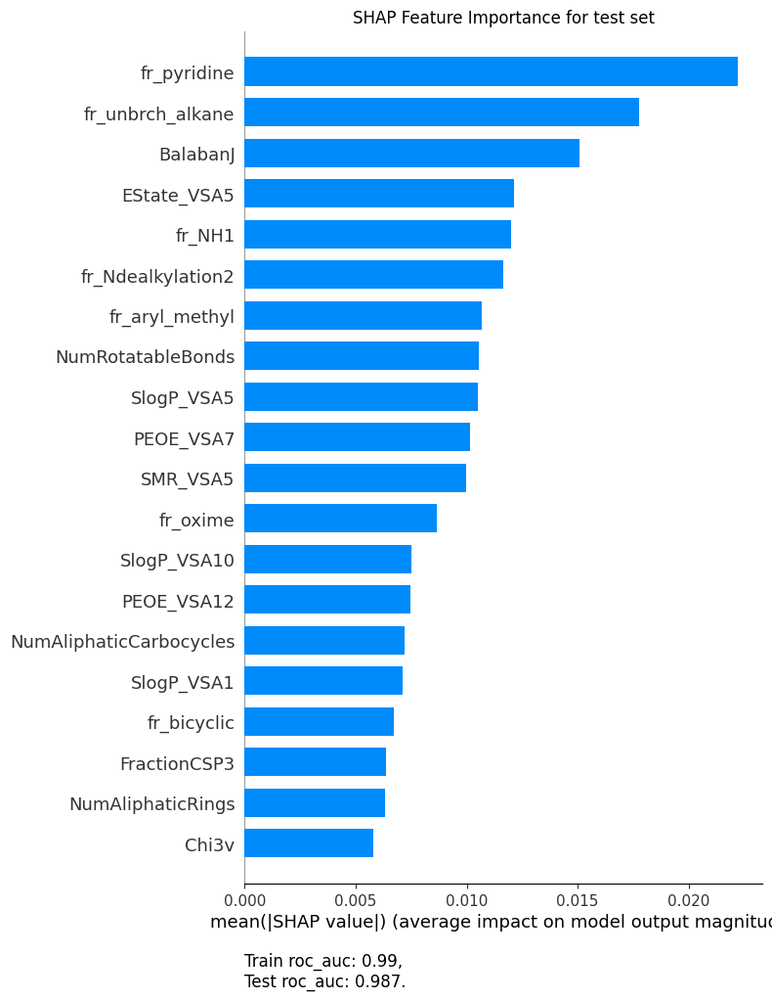

In [ ]:
ax = shap_interpreter.plot("importance")

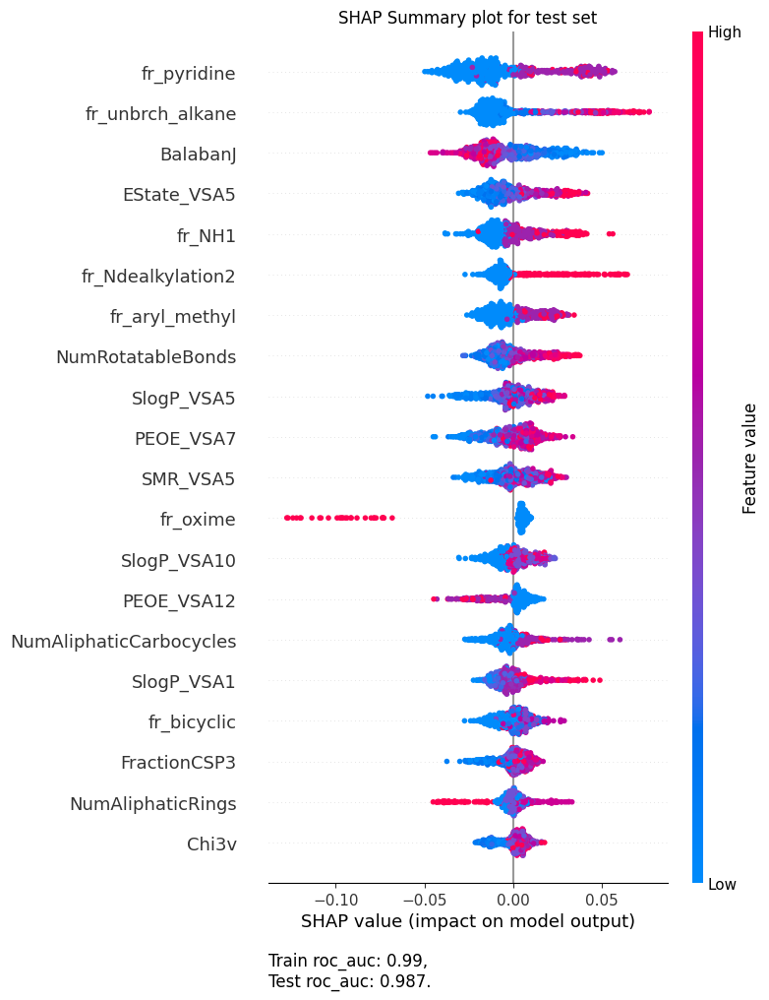

In [ ]:
ax = shap_interpreter.plot("summary")

### SHAP interpretation for 10 selected compounds

In [ ]:
combined_df

,Molecule ChEMBL ID,Smiles,IC50,classLabel,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,CHEMBL94,CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C,28.00,1,11.353370,-0.429125,11.353370,0.098109,0.848240,275.352,...,0,0,0,0,0,0,0,0,0,0
1,CHEMBL95,Nc1c2c(nc3ccccc13)CCCC2,45.10,1,6.199769,0.953981,6.199769,0.953981,0.706488,198.269,...,0,0,0,0,0,0,0,0,0,0
2,CHEMBL1255901,C/C=C1\[C@H]2C=C(C)C[C@@]1(N)c1ccc(=O)[nH]c1C2,5.00,1,11.454454,-0.434491,11.454454,0.041618,0.683535,242.322,...,0,0,0,0,0,0,0,0,0,0
3,CHEMBL502,COc1cc2c(cc1OC)C(=O)C(CC1CCN(Cc3ccccc3)CC1)C2,10.00,1,12.936933,0.108783,12.936933,0.108783,0.747461,379.500,...,0,0,0,0,0,0,0,0,0,0
4,CHEMBL75013,O=C(CCC1CCN(Cc2ccccc2)CC1)c1ccc2c(c1)NCCCC2,194.98,1,12.726380,0.306076,12.726380,0.306076,0.693540,376.544,...,0,0,0,0,0,0,0,0,0,0
5,CHEMBL659,COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2,2090.00,0,9.972866,-0.411699,9.972866,0.008380,0.800524,287.359,...,0,0,0,0,0,0,0,0,0,0
6,CHEMBL636,CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1,3030.00,0,11.651792,-0.326707,11.651792,0.284775,0.823422,250.342,...,0,0,0,0,0,0,0,0,0,0
7,CHEMBL54126,CN(C)C(=O)Oc1cccc([N+](C)(C)C)c1.[Br-],31.00,1,11.371809,-0.362445,11.371809,0.362445,0.717081,223.296,...,1,0,0,0,0,0,0,0,0,0
8,CHEMBL1128,CC[N+](C)(C)c1cccc(O)c1.[Cl-],5000.00,0,9.261910,0.339954,9.261910,0.339954,0.665970,166.244,...,1,0,0,0,0,0,0,0,0,0
9,CHEMBL359570,O=C1Cc2cc3c(CCC4CCN(Cc5ccccc5)CC4)noc3cc2N1,0.33,1,9.604241,0.065227,9.604241,0.065227,0.522778,375.472,...,0,0,0,0,0,0,0,0,0,0


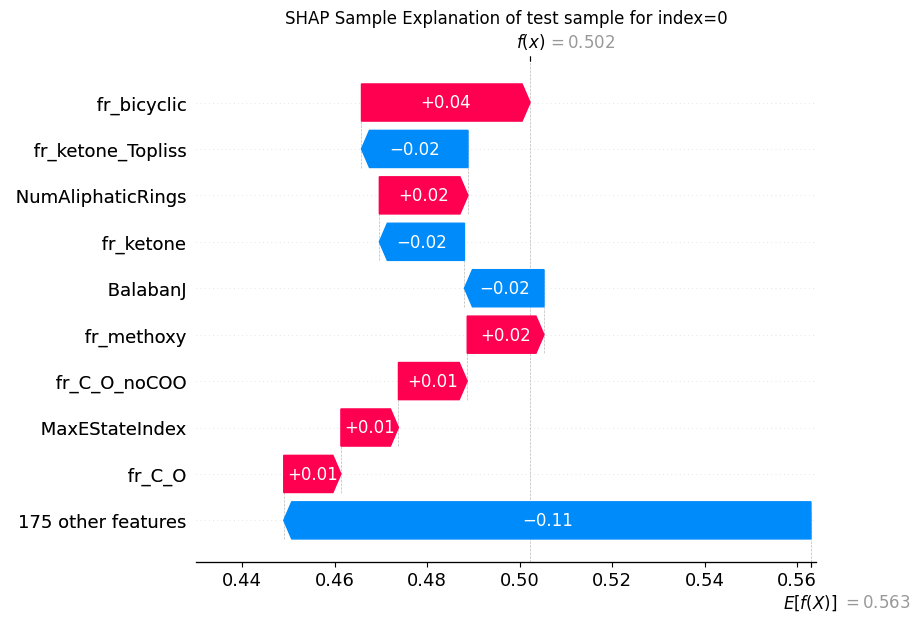

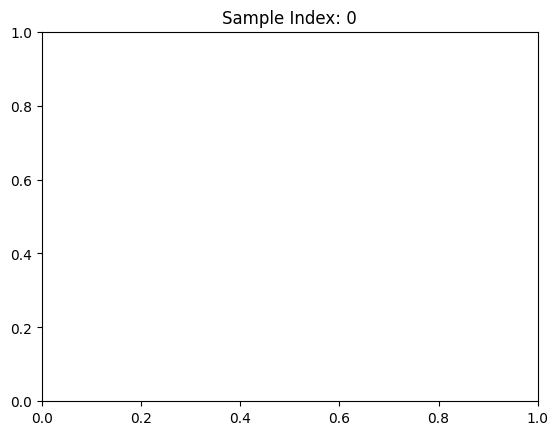

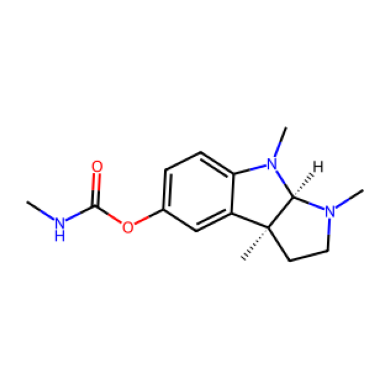

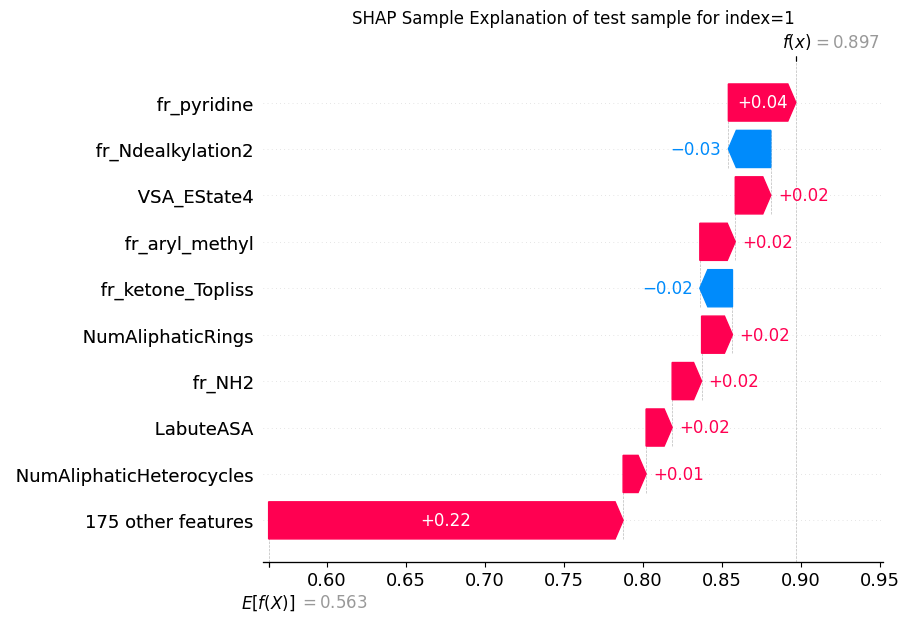

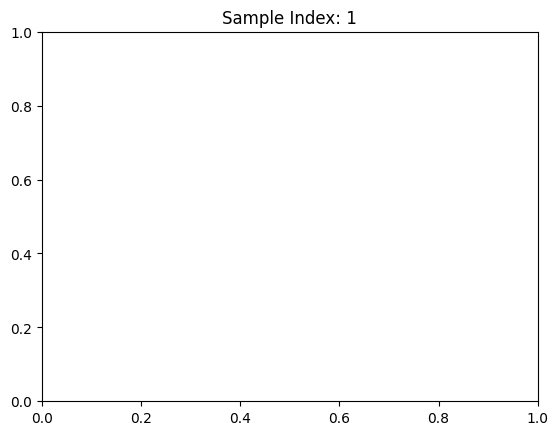

...

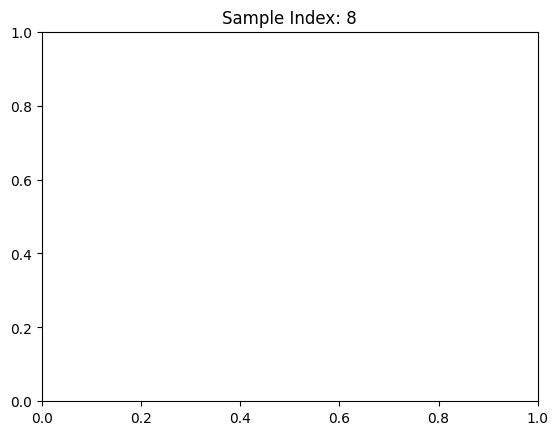

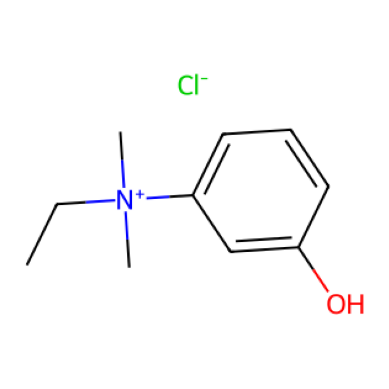

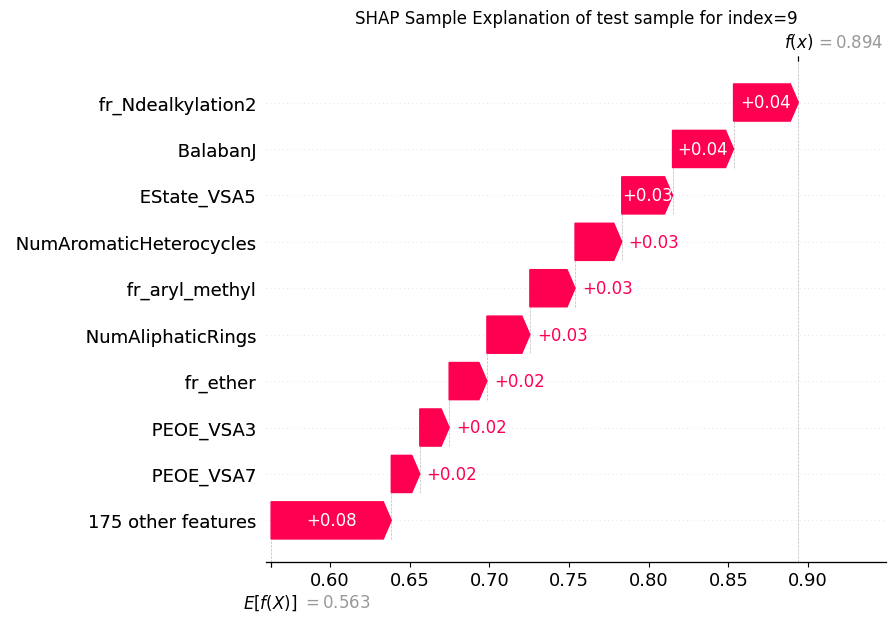

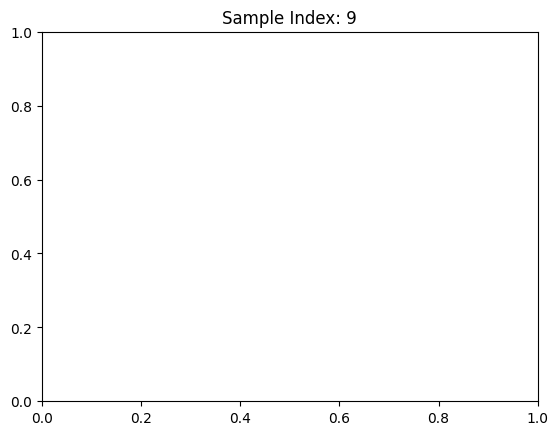

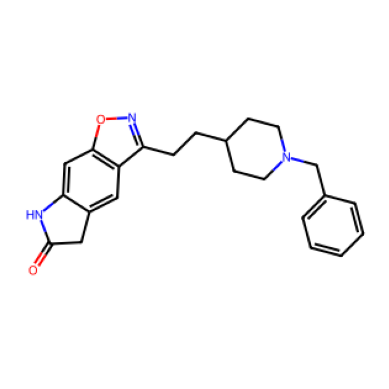

In [ ]:
import matplotlib.pyplot as plt
from rdkit import Chem
from rdkit.Chem import Draw

# Function to draw molecule from SMILES
def draw_molecule(smiles):
    mol = Chem.MolFromSmiles(smiles)
    return Draw.MolToImage(mol)

for i in range(10):
    # Get the sample index
    sample_index = combined_df.loc[:, 'MaxEStateIndex':].index.tolist()[i]

    # Generate the plot
    ax4 = shap_interpreter.plot('sample', samples_index=[sample_index])

    # Retrieve the corresponding SMILES value
    smiles_value = combined_df.loc[sample_index, 'Smiles']

    # Draw the molecular structure
    mol_img = draw_molecule(smiles_value)

    # Display the SHAP plot
    plt.title(f'Sample Index: {sample_index}')
    plt.show()

    # Display the molecular structure
    plt.imshow(mol_img)
    plt.axis('off')
    plt.show()


In [ ]:
shap_values[0]

.values =
array([ 0.00833961, -0.00833961])

.base_values =
array([0.5716038, 0.4283962])

.data =
5.972043485250375

## Prediction analysis

In [ ]:
df_humanIndependent=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_humanIndependent.xlsx')
df_eel=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_eel.xlsx')
df_mouse=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_mouse.xlsx')
df_cow=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_cow.xlsx')
df_ray=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_ray.xlsx')
df_mosquito=pd.read_excel('/content/drive/MyDrive/Predictive-Generative-transfer learning/TransferAll/CleanedTestDatasetSmiles/df_mosquito.xlsx')

In [ ]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem import Descriptors

def getMolDescriptors(mol, missingVal=None):

    res = {}
    for nm,fn in Descriptors._descList:
        try:
            val = fn(mol)
        except:
            # print the error message:
            import traceback
            traceback.print_exc()
            # and set the descriptor value to whatever missingVal is
            val = missingVal
        res[nm] = val
    return res

descriptor_list = []

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles in df_humanIndependent['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_humanIndependent_features = pd.DataFrame(descriptor_list)

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles in df_eel['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_eel_features = pd.DataFrame(descriptor_list)

for smiles in df_mouse['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_mouse_features = pd.DataFrame(descriptor_list)

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles in df_cow['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_cow_features = pd.DataFrame(descriptor_list)

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles in df_ray['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_ray_features = pd.DataFrame(descriptor_list)

# Iterate through the SMILES column and calculate descriptors for each molecule
for smiles in df_mosquito['cleanedMol']:
    mol = Chem.MolFromSmiles(smiles)

    # Check if the molecule is valid
    if mol is not None:
        # Calculate descriptors using your getMolDescriptors function
        descriptors = getMolDescriptors(mol, missingVal=None)

        # Add the descriptors to the list
        descriptor_list.append(descriptors)
    else:
        # Handle invalid or missing molecules if needed
        descriptor_list.append({})

# Convert the list of descriptors to a pandas DataFrame
df_mosquito_features = pd.DataFrame(descriptor_list)

df_humanIndependent = pd.concat([df_humanIndependent, df_humanIndependent_features], axis=1)
df_eel = pd.concat([df_eel, df_eel_features], axis=1)
df_mouse = pd.concat([df_mouse, df_mouse_features], axis=1)
df_cow = pd.concat([df_cow, df_cow_features], axis=1)
df_ray = pd.concat([df_ray, df_ray_features], axis=1)
df_mosquito = pd.concat([df_mosquito, df_mosquito_features], axis=1)

In [ ]:
df_humanIndependent=df_humanIndependent.dropna(subset=['Smiles'])
df_eel=df_eel.dropna(subset=['SMILES'])
df_mouse=df_mouse.dropna(subset=['SMILES'])
df_cow=df_cow.dropna(subset=['SMILES'])
df_ray=df_ray.dropna(subset=['SMILES'])
df_mosquito=df_mosquito.dropna(subset=['SMILES'])


In [ ]:
tpot_column=feature1.columns.tolist()

### Dataset Preparation




In [ ]:
df_humanIndependent_features_tpot=df_humanIndependent_features[tpot_column]
df_eel_features_tpot=df_eel_features[tpot_column]
df_mouse_features_tpot=df_mouse_features[tpot_column]
df_cow_features_tpot=df_cow_features[tpot_column]
df_ray_features_tpot=df_ray_features[tpot_column]
df_mosquito_features_tpot=df_mosquito_features[tpot_column]

In [ ]:
df_humanIndependent_tpot_final=pd.merge(df_humanIndependent[['cleanedMol', 'binary_activities']], df_humanIndependent_features_tpot, left_index=True, right_index=True)

In [ ]:
df_eel_tpot_final=pd.merge(df_eel[['cleanedMol', 'single-class-label']], df_eel_features_tpot, left_index=True, right_index=True)

In [ ]:
df_mouse_tpot_final=pd.merge(df_mouse[['cleanedMol', 'single-class-label']], df_mouse_features_tpot, left_index=True, right_index=True)
df_cow_tpot_final=pd.merge(df_cow[['cleanedMol', 'single-class-label']], df_cow_features_tpot, left_index=True, right_index=True)
df_ray_tpot_final=pd.merge(df_ray[['cleanedMol', 'single-class-label']], df_ray_features_tpot, left_index=True, right_index=True)
df_mosquito_tpot_final=pd.merge(df_mosquito[['cleanedMol', 'single-class-label']], df_mosquito_features_tpot, left_index=True, right_index=True)

In [ ]:
df_humanIndependent_tpot_final.rename(columns={'binary_activities': 'single-class-label'}, inplace=True)


In [ ]:
df_humanIndependent_tpot_final

,cleanedMol,single-class-label,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,COc1cc(N)c(Cl)cc1C(=O)CCC1CCN(Cc2cccc(C)c2)CC1,1,12.678109,0.070315,12.678109,0.070315,0.517626,400.950,371.718,400.191756,...,0,0,0,0,0,0,0,0,0,0
1,CCN(CCCCCn1c(C)cc(=O)n(CCCCCN(CC)Cc2ccccc2C#N)...,1,13.231128,-0.223812,13.231128,0.211490,0.185178,582.793,536.425,582.368225,...,0,0,0,0,0,0,0,0,4,0
2,CCN(CCCCCCn1c(C)cc(=O)n(CCCCCCN(CC)Cc2ccccc2C#...,1,13.225251,-0.208616,13.225251,0.192933,0.140817,610.847,560.447,610.399525,...,0,0,0,0,0,0,0,0,6,0
3,CCN(CCCCCn1c(=O)c2ccccc2n(CCCCCN(CC)Cc2ccccc2C...,1,13.624280,-0.226583,13.624280,0.211682,0.121615,618.826,572.458,618.368225,...,0,0,0,0,0,0,0,0,4,0
4,C[n+]1c2c(c(N)c3ccccc31)CCCC2,0,6.295324,1.003148,6.295324,1.003148,0.667469,213.304,196.168,213.138625,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,COc1ccc2c(=O)cc(C(=O)Nc3ccc(CN(C)Cc4ccccc4)cc3...,0,12.709629,-0.374291,12.709629,0.196689,0.457871,427.504,402.304,427.189592,...,0,0,0,0,0,0,0,0,0,0
204,COc1cc2[nH]c(C(=O)Nc3ccc(CN(C)Cc4ccccc4)cc3)cc...,0,12.808047,-0.400249,12.808047,0.163325,0.409022,457.530,430.314,457.200156,...,0,0,0,0,0,0,0,0,0,0
205,CCN(CCCCn1c(C)cc(=O)n(CCCCN(CC)Cc2ccccc2C#N)c1...,1,13.246372,-0.243184,13.246372,0.235564,0.238857,554.739,512.403,554.336925,...,0,0,0,0,0,0,0,0,2,0
206,Cc1cc(=O)n(CCCCCNCc2ccccc2C#N)c(=O)n1CCCCCNCc1...,1,13.026137,-0.234411,13.026137,0.224564,0.272877,526.685,488.381,526.305624,...,0,0,0,0,0,0,0,0,8,0


In [ ]:
df_humanIndependent_tpot_final.loc[:, 'MaxEStateIndex':]

,MaxEStateIndex,MinEStateIndex,MaxAbsEStateIndex,MinAbsEStateIndex,qed,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,FpDensityMorgan1,...,fr_quatN,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiophene,fr_unbrch_alkane,fr_urea
0,12.678109,0.070315,12.678109,0.070315,0.517626,400.950,371.718,400.191756,150,1.250000,...,0,0,0,0,0,0,0,0,0,0
1,13.231128,-0.223812,13.231128,0.211490,0.185178,582.793,536.425,582.368225,228,0.674419,...,0,0,0,0,0,0,0,0,4,0
2,13.225251,-0.208616,13.225251,0.192933,0.140817,610.847,560.447,610.399525,240,0.644444,...,0,0,0,0,0,0,0,0,6,0
3,13.624280,-0.226583,13.624280,0.211682,0.121615,618.826,572.458,618.368225,240,0.608696,...,0,0,0,0,0,0,0,0,4,0
4,6.295324,1.003148,6.295324,1.003148,0.667469,213.304,196.168,213.138625,82,1.125000,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,12.709629,-0.374291,12.709629,0.196689,0.457871,427.504,402.304,427.189592,162,0.937500,...,0,0,0,0,0,0,0,0,0,0
204,12.808047,-0.400249,12.808047,0.163325,0.409022,457.530,430.314,457.200156,174,0.882353,...,0,0,0,0,0,0,0,0,0,0
205,13.246372,-0.243184,13.246372,0.235564,0.238857,554.739,512.403,554.336925,216,0.707317,...,0,0,0,0,0,0,0,0,2,0
206,13.026137,-0.234411,13.026137,0.224564,0.272877,526.685,488.381,526.305624,204,0.692308,...,0,0,0,0,0,0,0,0,8,0


### Test dataset Preparation

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(feature1, target, test_size=0.20, random_state=42)


In [ ]:
test_df = pd.merge(df[['cleanedMol', 'classLabel']], X_test, left_index=True, right_index=True, how='inner')

In [ ]:
test_df.rename(columns={'classLabel': 'single-class-label'}, inplace=True)


Confusion Matrix for Human Test dataset:
[[445  21]
 [ 21 329]]
Confusion Matrix for Human Independent dataset:
[[124  14]
 [ 24  46]]


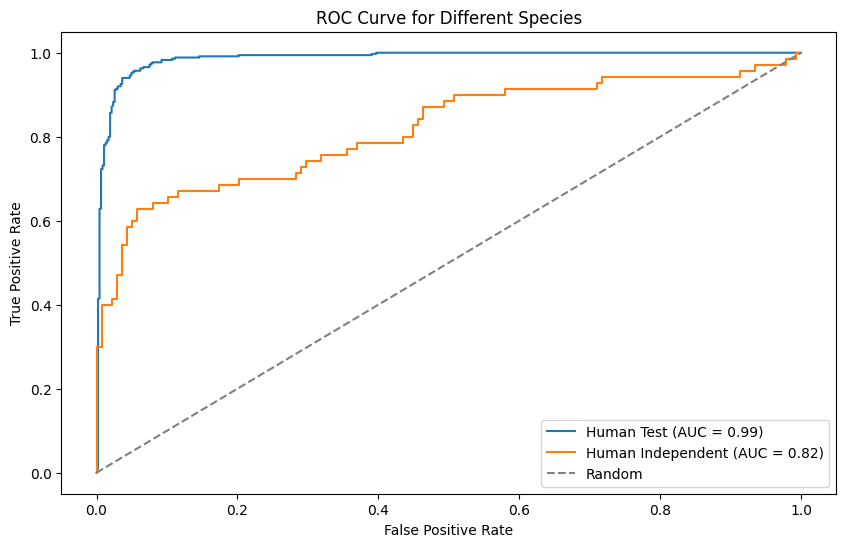

Evaluation for Human Test dataset:
Accuracy: 0.9485
Precision: 0.9400
Recall: 0.9400
F1 Score: 0.9400
MCC: 0.8949
Cohen's Kappa: 0.8949
Predicted Positives: 350.0000
Predicted Negatives: 466.0000


Evaluation for Human Independent dataset:
Accuracy: 0.8173
Precision: 0.7667
Recall: 0.6571
F1 Score: 0.7077
MCC: 0.5796
Cohen's Kappa: 0.5760
Predicted Positives: 60.0000
Predicted Negatives: 148.0000




In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, cohen_kappa_score, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

datasets = {
    'Human Test': test_df,
    'Human Independent': df_humanIndependent_tpot_final
}

# Set up the plot
plt.figure(figsize=(10, 6))

# Initialize a dictionary to store evaluation metrics for each dataset
evaluation_metrics = {}

# Create new datasets for predictions and probabilities
datasets_with_predictions = {}

# Evaluate and plot ROC curve for each dataset
for species, data in datasets.items():
    X = data.loc[:, 'MaxEStateIndex':]
    y = data['single-class-label']
    # Prediction probabilities for each class
    y_pred_probs = best_pipeline.predict_proba(X)

    # Binary predictions
    y_pred_binary = best_pipeline.predict(X)

    # Clone the original dataset
    new_data = data.copy()

    # Append binary predictions and prediction probabilities to the new dataset
    new_data['Binary_Prediction'] = y_pred_binary
    new_data['Class_0_Prob'] = y_pred_probs[:, 0]
    new_data['Class_1_Prob'] = y_pred_probs[:, 1]

    # Store the new dataset in the dictionary
    datasets_with_predictions[species] = new_data

    # Store the evaluation metrics in the dictionary
    evaluation_metrics[species] = {
        'Accuracy': accuracy_score(y, y_pred_binary),
        'Precision': precision_score(y, y_pred_binary),
        'Recall': recall_score(y, y_pred_binary),
        'F1 Score': f1_score(y, y_pred_binary),
        'MCC': matthews_corrcoef(y, y_pred_binary),
        "Cohen's Kappa": cohen_kappa_score(y, y_pred_binary),
        'Predicted Positives': sum(y_pred_binary == 1),
        'Predicted Negatives': sum(y_pred_binary == 0)
    }

    # Plot the ROC curve for each species
    fpr, tpr, _ = roc_curve(y, y_pred_probs[:, 1])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'{species} (AUC = {roc_auc:.2f})')

    # Display Confusion Matrix
    print(f"Confusion Matrix for {species} dataset:")
    print(confusion_matrix(y, y_pred_binary))

# Plot settings
plt.plot([0, 1], [0, 1], linestyle='--', color='gray', label='Random')
plt.title('ROC Curve for Different Species')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()

# Display or analyze the stored evaluation metrics
for species, metrics in evaluation_metrics.items():
    print(f"Evaluation for {species} dataset:")
    for metric_name, value in metrics.items():
        print(f"{metric_name}: {value:.4f}")
    print("\n")

# Create a DataFrame from the evaluation_metrics dictionary
df_metrics = pd.DataFrame(evaluation_metrics).transpose()

# Save the DataFrames to Excel files
df_metrics.to_excel('evaluation_metrics_tpot.xlsx', index_label='Species')

# Access the datasets with predictions if needed
human_test_with_predictions = datasets_with_predictions['Human Test']
human_independent_with_predictions = datasets_with_predictions['Human Independent']


In [ ]:
import pandas as pd
human_test_with_predictions_filtered = human_test_with_predictions[human_test_with_predictions['single-class-label'] != human_test_with_predictions['Binary_Prediction']]


In [ ]:
df=human_test_with_predictions_filtered

### Interactive violin plot visualization for distribution of prediction porbabilities

In [ ]:
pip install -U kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.6 MB/s eta 0:00:00


In [ ]:
import pandas as pd
human_independent_with_predictions_filtered = human_test_with_predictions[human_test_with_predictions['single-class-label'] != human_test_with_predictions['Binary_Prediction']]


In [ ]:
df=human_independent_with_predictions_filtered

### Distribution plot for class 1 prediction probabilities(Human Independent)

In [ ]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go

# Extract True Positives, True Negatives, False Positives, and False Negatives for Human Independent dataset
true_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 1) & (human_independent_with_predictions['Binary_Prediction'] == 1)]
true_negatives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 0) & (human_independent_with_predictions['Binary_Prediction'] == 0)]
false_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 0) & (human_independent_with_predictions['Binary_Prediction'] == 1)]
false_negatives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 1) & (human_independent_with_predictions['Binary_Prediction'] == 0)]

# Create subplots for Human Independent dataset
fig_hi = sp.make_subplots(rows=1, cols=1, subplot_titles=['Human Independent'])

# Add violin traces for Human Independent
fig_hi.add_trace(go.Violin(x=true_positives_hi['Binary_Prediction'], y=true_positives_hi['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=false_positives_hi['Binary_Prediction'], y=false_positives_hi['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=true_negatives_hi['Binary_Prediction'], y=true_negatives_hi['Class_1_Prob'], name='True Negatives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))
fig_hi.add_trace(go.Violin(x=false_negatives_hi['Binary_Prediction'], y=false_negatives_hi['Class_1_Prob'], name='False Negatives', box_visible=True, points='all', jitter=0.3, marker=dict(size=6)))

# Update layout for better presentation
fig_hi.update_layout(
    template='plotly_white',
    title='Violin Plots with Data Points for True Positives, False Positives, True Negatives, and False Negatives (Human Independent)',
    xaxis=dict(title='Binary Prediction', showgrid=False),
    yaxis=dict(title='Class 1 Probability', showgrid=False),
    violingap=0
)


### Distribution plot for class 1 prediction probabilities(Human Test)

In [ ]:
# Extract True Positives, True Negatives, False Positives, and False Negatives for Human Test dataset
true_positives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 1)]
true_negatives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 0)]
false_positives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 1)]
false_negatives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 0)]

# Create a figure for Human Test dataset
fig_ht = go.Figure()

# Add violin traces for Human Test
fig_ht.add_trace(go.Violin(x=true_positives_ht['Binary_Prediction'], y=true_positives_ht['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=false_positives_ht['Binary_Prediction'], y=false_positives_ht['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=true_negatives_ht['Binary_Prediction'], y=true_negatives_ht['Class_1_Prob'], name='True Negatives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))
fig_ht.add_trace(go.Violin(x=false_negatives_ht['Binary_Prediction'], y=false_negatives_ht['Class_1_Prob'], name='False Negatives', box_visible=True, points='all', jitter=0.2, marker=dict(size=6)))

# Update layout for better presentation
fig_ht.update_layout(template='plotly_white', title='Violin Plots with Data Points for True Positives, False Positives, True Negatives, and False Negatives (Human Test)')
fig_ht.update_xaxes(title_text='Binary Prediction', showgrid=False)  # Remove gridlines on x-axis
fig_ht.update_yaxes(title_text='Class 1 Probability', showgrid=False)  # Remove gridlines on y-axis
fig_ht.update_layout(violingap=0)  # Set gap between violins to zero for closer appearance


### Distribution of class 1 probabilities for positive prediction(Human Indenpendent)





In [ ]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go
from IPython.display import display, Image

# Extract True Positives and False Positives for Human Independent dataset
true_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 1) & (human_independent_with_predictions['Binary_Prediction'] == 1)]
false_positives_hi = human_independent_with_predictions[(human_independent_with_predictions['single-class-label'] == 0) & (human_independent_with_predictions['Binary_Prediction'] == 1)]

# Create subplots for Human Independent dataset
fig_hi = sp.make_subplots(rows=1, cols=1, subplot_titles=['True Positives and False Positives'])

# Add violin traces for True Positives and False Positives
fig_hi.add_trace(go.Violin(x=true_positives_hi['Binary_Prediction'], y=true_positives_hi['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='blue')), row=1, col=1)
fig_hi.add_trace(go.Violin(x=false_positives_hi['Binary_Prediction'], y=false_positives_hi['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='orange')), row=1, col=1)

# Update layout for better presentation
fig_hi.update_layout(template='plotly_white', title='Violin Plot with Data Points for True Positives and False Positives (Human Independent)', height=1000, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
fig_hi.update_xaxes(title_text='Binary Prediction', row=1, col=1)
fig_hi.update_yaxes(title_text='Class 1 Probability', row=1, col=1)
fig_hi.update_xaxes(showgrid=False, row=1, col=1)
fig_hi.update_yaxes(showgrid=False, row=1, col=1)
fig_hi.update_layout(violingap=0)
fig_hi.update_traces(meanline_visible=True)


### Distribution of class 1 probabilities for positive prediction(Human Test)

In [ ]:
import pandas as pd
import plotly.subplots as sp
import plotly.graph_objects as go
from IPython.display import display, Image
# Extract True Positives and False Positives for Human Independent dataset
true_positives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 1) & (human_test_with_predictions['Binary_Prediction'] == 1)]
false_positives_ht = human_test_with_predictions[(human_test_with_predictions['single-class-label'] == 0) & (human_test_with_predictions['Binary_Prediction'] == 1)]

# Create subplots for Human Independent dataset
fig_ht = sp.make_subplots(rows=1, cols=1, subplot_titles=['True Positives and False Positives'])

# Add violin traces for True Positives and False Positives
fig_ht.add_trace(go.Violin(x=true_positives_ht['Binary_Prediction'], y=true_positives_ht['Class_1_Prob'], name='True Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='blue')), row=1, col=1)
fig_ht.add_trace(go.Violin(x=false_positives_ht['Binary_Prediction'], y=false_positives_ht['Class_1_Prob'], name='False Positives', box_visible=True, points='all', jitter=0.2, marker=dict(size=5), line=dict(color='orange')), row=1, col=1)

# Update layout for better presentation
fig_ht.update_layout(template='plotly_white', title='Violin Plot with Data Points for True Positives and False Positives (Human Independent)', height=1000, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.01))
fig_ht.update_xaxes(title_text='Binary Prediction', row=1, col=1)
fig_ht.update_yaxes(title_text='Class 1 Probability', row=1, col=1)
fig_ht.update_xaxes(showgrid=False, row=1, col=1)
fig_ht.update_yaxes(showgrid=False, row=1, col=1)
fig_ht.update_layout(violingap=0)
fig_ht.update_traces(meanline_visible=True)


## Conclusion



1.  Important features for selected compounds for the prediction were displayed
2.  Prediction probability cutoff of 0.8 is optimal for accurate prediction



## References


*   Ribeiro, M. T., Singh, S., & Guestrin, C. (2016). “Why Should I Trust You?”: Explaining the Predictions of Any Classifier (arXiv:1602.04938). arXiv. http://arxiv.org/abs/1602.04938

*   https://colab.research.google.com/github/ing-bank/probatus/blob/master/docs/tutorials/nb_shap_model_interpreter.ipynb

*   Jiménez-Luna, J., Grisoni, F., & Schneider, G. (2020). Drug discovery with explainable artificial intelligence. Nature Machine Intelligence, 2(10), 573–584. https://doi.org/10.1038/s42256-020-00236-4
*  Muthukrishnan, R., & Rohini, R. (2016). LASSO: A feature selection technique in predictive modeling for machine learning. 2016 IEEE International Conference on Advances in Computer Applications (ICACA), 18–20. https://doi.org/10.1109/ICACA.2016.7887916
*   Rdkit.Chem.Descriptors module. (2024). RDKiT. https://www.rdkit.org/docs/source/rdkit.Chem.Descriptors.html
* https://greglandrum.github.io/rdkit-blog/posts/2022-12-23-descriptor-tutorial.html
*   Vignaux, P. A., Lane, T. R., Urbina, F., Gerlach, J., Puhl, A. C., Snyder, S. H., & Ekins, S. (2023). Validation of Acetylcholinesterase Inhibition Machine Learning Models for Multiple Species. Chemical Research in Toxicology, 36(2), 188–201. https://doi.org/10.1021/acs.chemrestox.2c00283



